## Clustering using Word2Vec vectors

- I will use `Word2Vec` to get the word vectors and will average to get the sentence vectors.
- I have trained `Word2Vec` on amazon reviews dataset containing `3M` sentences and fine-tuned on our dataset.
- I will use `MiniBatchKMeans` and `community_detection` algorithm for Clustering.

There are a few issues with `community_detection` algorithm
- It doesn't confirm each data points to be clustered.
- Taking more time and space.
- It is better to use scalable version of community_detection.
- Details will be discussed later in the notebook...

#### Loading our clustering dataset

##### importing libraries

In [18]:
# imports
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

from gensim.models import Word2Vec
import nltk
import numpy as np
import gensim
from time import time
from typing import List

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn import metrics

from scipy.spatial.distance import cdist

from utils import fit_and_evaluate

In [2]:
# loading clustering.xlsx dataset
dataset_dir = Path("../dataset")
dataset_path = dataset_dir/"clustering.xlsx"

dataset = pd.read_excel(open(dataset_path, "rb"))
original_dataset = dataset[["Text"]]
dataset = dataset[["Text"]]
dataset.head()

,Text
0,"Moeller's student-run newspaper, The Crusader,..."
1,"In 2008, The Crusader won First Place, the sec..."
2,The Squire is a student literary journal that ...
3,Paul Keels - play-by-play announcer for Ohio S...
4,Joe Uecker - Ohio State Senator (R-66) .


#### loading fine-tuned word2vec model 

In [3]:
model_path = "../dataset/word2vec/clustering_word2vec.model"
w2v_model = Word2Vec.load(model_path)

__Have a look at the w2v_model's performance__

In [4]:
w2v_model.wv.most_similar("student")

[('students', 0.685517430305481),
 ('teacher', 0.6712746024131775),
 ('professor', 0.6168493032455444),
 ('undergraduates', 0.6094286441802979),
 ('graduate', 0.6058364510536194),
 ('practitioner', 0.5949206352233887),
 ('lecturer', 0.5820600986480713),
 ('grad', 0.5799664258956909),
 ('applicant', 0.5761821866035461),
 ('textbook', 0.5712612867355347)]

In [5]:
w2v_model.wv.most_similar("crusader")

[('tyrant', 0.6120697259902954),
 ('warlord', 0.5712436437606812),
 ('stronghold', 0.5492900609970093),
 ('mercenary', 0.5314667224884033),
 ('warriors', 0.5216918587684631),
 ('swordsman', 0.5211747288703918),
 ('warrior', 0.5182107090950012),
 ('barbarians', 0.5135986804962158),
 ('conqueror', 0.5098450183868408),
 ('rebellion', 0.5082306265830994)]

In [6]:
w2v_model.wv.most_similar("moeller")

[('lund', 0.5227487683296204),
 ('pratt', 0.5216526389122009),
 ('dunbar', 0.5156900882720947),
 ('ret', 0.5137043595314026),
 ('larsen', 0.5115369558334351),
 ('newell', 0.5113091468811035),
 ('mccarty', 0.49209073185920715),
 ('geary', 0.4899079203605652),
 ('wilkins', 0.4855107069015503),
 ('manning', 0.48166534304618835)]

___The model seems to be working good___

### preprocess the text

Using `gensim` library. As we preprocess the dataset usign `gensim` itself to fine-tune trained `word2Vec` model. (NOTE: I have trained the Word2Vec model on amazon reviews)

In [7]:
t0 = time()
dataset["Text"] = dataset["Text"].apply(gensim.utils.simple_preprocess)
print(f"time taken to preprocess: {time()-t0} s")

time taken to preprocess: 5.521860361099243 s


In [8]:
dataset.head()

,Text
0,"[moeller, student, run, newspaper, the, crusad..."
1,"[in, the, crusader, won, first, place, the, se..."
2,"[the, squire, is, student, literary, journal, ..."
3,"[paul, keels, play, by, play, announcer, for, ..."
4,"[joe, uecker, ohio, state, senator]"


In [9]:
from typing import List
def vectorizer(sentence:List[str], model):
    """
    this vector get the vector for each word and average it
    
    Parameters
    ----------
    sentence: Union[str, List[str]]
        sentence to get the vector of
    model:
        word2vec model
    """
    vector = np.zeros(300)
    word_count = 0
    if len(sentence)==0:
        return np.zeros(300)
    for word in sentence:
        # get the word vector
        try:
            if word_count==0:
                vector = model[word]
            else:
                vector = np.add(vector, model[word])
            word_count+=1
        except:
            pass
    return np.asarray(vector)/word_count

#### Getting vectors for each sentece

In [11]:
t0 = time()
sentence_embeddings = dataset["Text"].apply(lambda x:vectorizer(x, w2v_model.wv))
# changing sentece_vectors to 2D array
sentence_embeddings = np.vstack(sentence_embeddings.values)
print(f"time taken to get vector for each sentence is: {time() - t0}")

time taken to get vector for each sentence is: 11.528823375701904


In [12]:
# shape of sentence embedding
sentence_embeddings.shape

(46117, 300)

In [13]:
n_items = sentence_embeddings.shape[0]

### Visualize data in 3D

In [18]:
# !pip install cufflinks plotly

In [49]:
# to visualize high-dimensional data into lower-dimension(2D)
import plotly.express as px
def visualize_data_3d(X, labels=None, path=None)->None:
    """
    this method takes high-dimensional data and change it into lower-dimension
    using PCA. (3D)
    """
    pca = PCA(n_components=3, svd_solver="auto")
    components = pca.fit_transform(X)
    total_var = pca.explained_variance_ratio_.sum()*100
    
    X_pca = pd.DataFrame({"0":components[:,0], "1":components[:,1], "2": components[:,2]})
    
    fig = px.scatter_3d(
        components, x=0, y=1, z=2, color=labels,
        title=f"Total Explained Variance: {total_var:.2f}%",
        labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'},
    )
    if path is not None:
        fig.write_html(path)
    fig.show()

In [20]:
visualize_data_3d(sentence_vectors)

## Clustering given data using MiniBatchKMeans

### finding the optimal value of K using Elbow method

In [15]:
def getting_distortion_and_inertia(X, K:List[int]):
    """
    this method calculate distortions and Inertias and return

    Returns
    -------
    distortions: List

    inertias: List

    mapping1: Dict(K, distortion)
    
    mapping2: Dict(K, Inertias)
    """
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    count=1
    for k in K:
        t0 = time()
        # Building and fitting the model
        kmeans_model = MiniBatchKMeans(n_clusters=k).fit(X)
        kmeans_model.fit(X)
    
        distortions.append(sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                            'euclidean'), axis=1)) / X.shape[0])
        inertias.append(kmeans_model.inertia_)
    
        mapping1[k] = sum(np.min(cdist(X, kmeans_model.cluster_centers_,
                                    'euclidean'), axis=1)) / X.shape[0]
        mapping2[k] = kmeans_model.inertia_

        print(f"Time taken in iteration {count} = {time()-t0}s")
        count+=1

    return (
        distortions,
        inertias,
        mapping1,
        mapping2,
    )

In [16]:
list_of_cluster_size = range(1,300)
distortions, inertias, mapping1, mapping2 = getting_distortion_and_inertia(sentence_vectors, list_of_cluster_size)

Time taken in iteration 1 = 1.2810463905334473s
Time taken in iteration 2 = 1.401564598083496s
Time taken in iteration 3 = 1.2994580268859863s
Time taken in iteration 4 = 1.4531569480895996s
Time taken in iteration 5 = 1.6456868648529053s
Time taken in iteration 6 = 1.4622573852539062s
Time taken in iteration 7 = 2.0110862255096436s
Time taken in iteration 8 = 1.9121975898742676s
Time taken in iteration 9 = 2.253262758255005s
Time taken in iteration 10 = 2.6320297718048096s
Time taken in iteration 11 = 2.2101361751556396s
Time taken in iteration 12 = 2.604973554611206s
Time taken in iteration 13 = 2.0468533039093018s
Time taken in iteration 14 = 2.8375015258789062s
Time taken in iteration 15 = 2.779015064239502s
Time taken in iteration 16 = 2.875890016555786s
Time taken in iteration 17 = 3.611976385116577s
Time taken in iteration 18 = 3.3353750705718994s
Time taken in iteration 19 = 3.1755266189575195s
Time taken in iteration 20 = 3.0785505771636963s
Time taken in iteration 21 = 3.0276

Time taken in iteration 170 = 16.272711992263794s
Time taken in iteration 171 = 16.886608600616455s
Time taken in iteration 172 = 15.865314722061157s
Time taken in iteration 173 = 15.636676549911499s
Time taken in iteration 174 = 17.673561334609985s
Time taken in iteration 175 = 15.173529624938965s
Time taken in iteration 176 = 16.097434282302856s
Time taken in iteration 177 = 15.736920595169067s
Time taken in iteration 178 = 16.02526545524597s
Time taken in iteration 179 = 15.503731966018677s
Time taken in iteration 180 = 15.529057502746582s
Time taken in iteration 181 = 15.851032733917236s
Time taken in iteration 182 = 17.20046591758728s
Time taken in iteration 183 = 16.109158277511597s
Time taken in iteration 184 = 15.559215068817139s
Time taken in iteration 185 = 14.86011266708374s
Time taken in iteration 186 = 15.170143604278564s
Time taken in iteration 187 = 14.89214015007019s
Time taken in iteration 188 = 16.95692753791809s
Time taken in iteration 189 = 16.26412272453308s
Time t

#### Tabulating and Visualizing the result

In [19]:
# using different values of distortions
# for key, value in mapping1.items():
#     print(f"{key}: {value}")

In [27]:
list_of_cluster_size[1:]

range(2, 300)

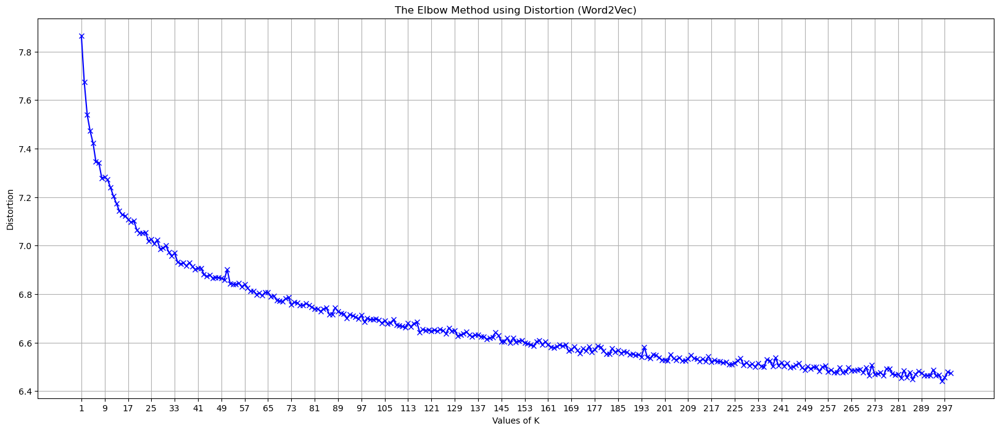

In [51]:
# plotting distortions
plt.figure(figsize=(20,8))
plt.plot(
    list_of_cluster_size,
    distortions, 
    'bx-'
)
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::8])
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion (Word2Vec)')
plt.grid()
plt.show()

In [ ]:
# using different values of Inertia
# for key, value in mapping2.items():
#     print(f"{key}: {value}")

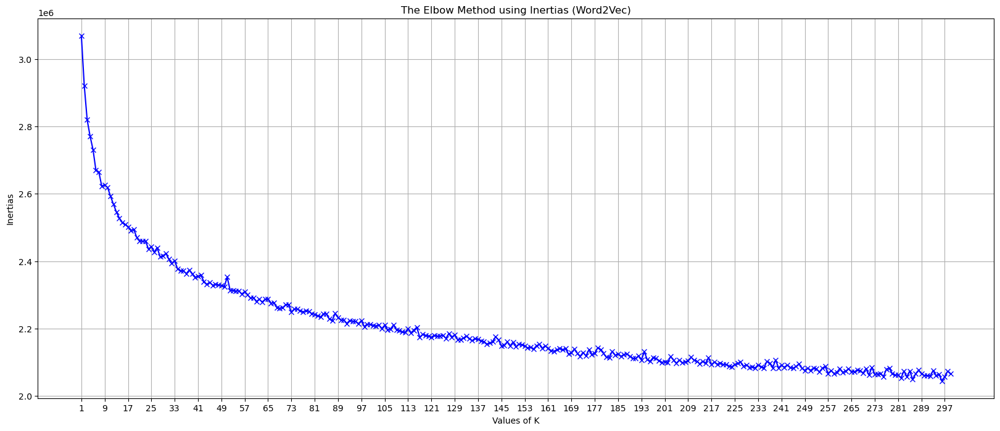

In [52]:
# plotting distortions 
plt.figure(figsize=(20,8))
plt.plot(list_of_cluster_size, inertias, 'bx-')
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[::8])
plt.ylabel('Inertias')
plt.title('The Elbow Method using Inertias (Word2Vec)')
plt.grid()
plt.show()

### Let's evaluate model on different `n_clusters` value using `Silhouette coefficient`

In [32]:
# fit and evaluate is used to fit and evaluate K-Means model on Silhouette Coefficient
from utils import fit_and_evaluate

count=1
scores = {}

for i in list_of_cluster_size[1:]:
    print(f"====== iteration : {count} , n_clusters: {i}======")
    kmeans = MiniBatchKMeans(
        n_clusters=i,
        max_iter=100,
        n_init=10,
    )
    score_dict = fit_and_evaluate(kmeans,sentence_vectors)
    scores[i] = score_dict
    count+=1
    print()

====== iteration : 1 , n_clusters: 2======
Clustering done in 0.27 ± 0.14 s
Silhouette Coefficient: 0.060 ± 0.023
Calinski-Harabasz Index: 2212.559 ± 226.968
Davies-Bouldin Index: 4.188 ± 0.444

====== iteration : 2 , n_clusters: 3======
Clustering done in 0.26 ± 0.03 s
Silhouette Coefficient: 0.039 ± 0.005
Calinski-Harabasz Index: 2003.346 ± 31.453
Davies-Bouldin Index: 3.953 ± 0.077

====== iteration : 3 , n_clusters: 4======
Clustering done in 0.25 ± 0.04 s
Silhouette Coefficient: 0.033 ± 0.003
Calinski-Harabasz Index: 1726.327 ± 168.600
Davies-Bouldin Index: 3.776 ± 0.163

====== iteration : 4 , n_clusters: 5======
Clustering done in 0.26 ± 0.03 s
Silhouette Coefficient: 0.021 ± 0.005
Calinski-Harabasz Index: 1532.863 ± 99.056
Davies-Bouldin Index: 3.790 ± 0.136

====== iteration : 5 , n_clusters: 6======
Clustering done in 0.32 ± 0.08 s
Silhouette Coefficient: 0.022 ± 0.002
Calinski-Harabasz Index: 1344.656 ± 47.951
Davies-Bouldin Index: 3.890 ± 0.107

====== iteration : 6 , n_clu

Clustering done in 0.81 ± 0.04 s
Silhouette Coefficient: -0.014 ± 0.005
Calinski-Harabasz Index: 333.161 ± 4.289
Davies-Bouldin Index: 3.774 ± 0.088

====== iteration : 44 , n_clusters: 45======
Clustering done in 0.86 ± 0.13 s
Silhouette Coefficient: -0.013 ± 0.005
Calinski-Harabasz Index: 331.522 ± 2.363
Davies-Bouldin Index: 3.728 ± 0.047

====== iteration : 45 , n_clusters: 46======
Clustering done in 0.71 ± 0.03 s
Silhouette Coefficient: -0.014 ± 0.002
Calinski-Harabasz Index: 323.579 ± 1.548
Davies-Bouldin Index: 3.680 ± 0.026

====== iteration : 46 , n_clusters: 47======
Clustering done in 0.78 ± 0.02 s
Silhouette Coefficient: -0.015 ± 0.004
Calinski-Harabasz Index: 319.498 ± 2.147
Davies-Bouldin Index: 3.743 ± 0.048

====== iteration : 47 , n_clusters: 48======
Clustering done in 0.87 ± 0.11 s
Silhouette Coefficient: -0.014 ± 0.002
Calinski-Harabasz Index: 314.910 ± 2.244
Davies-Bouldin Index: 3.715 ± 0.097

====== iteration : 48 , n_clusters: 49======
Clustering done in 0.86 ±

Clustering done in 1.26 ± 0.07 s
Silhouette Coefficient: -0.016 ± 0.004
Calinski-Harabasz Index: 202.967 ± 2.015
Davies-Bouldin Index: 3.598 ± 0.052

====== iteration : 87 , n_clusters: 88======
Clustering done in 1.35 ± 0.08 s
Silhouette Coefficient: -0.017 ± 0.006
Calinski-Harabasz Index: 200.458 ± 0.996
Davies-Bouldin Index: 3.590 ± 0.094

====== iteration : 88 , n_clusters: 89======
Clustering done in 1.23 ± 0.08 s
Silhouette Coefficient: -0.015 ± 0.002
Calinski-Harabasz Index: 200.222 ± 1.189
Davies-Bouldin Index: 3.548 ± 0.071

====== iteration : 89 , n_clusters: 90======
Clustering done in 1.29 ± 0.12 s
Silhouette Coefficient: -0.024 ± 0.015
Calinski-Harabasz Index: 198.795 ± 2.341
Davies-Bouldin Index: 3.552 ± 0.059

====== iteration : 90 , n_clusters: 91======
Clustering done in 1.31 ± 0.06 s
Silhouette Coefficient: -0.018 ± 0.004
Calinski-Harabasz Index: 196.106 ± 1.046
Davies-Bouldin Index: 3.580 ± 0.060

====== iteration : 91 , n_clusters: 92======
Clustering done in 1.35 ±

Clustering done in 1.88 ± 0.12 s
Silhouette Coefficient: -0.019 ± 0.004
Calinski-Harabasz Index: 151.292 ± 1.158
Davies-Bouldin Index: 3.496 ± 0.055

====== iteration : 129 , n_clusters: 130======
Clustering done in 2.90 ± 0.99 s
Silhouette Coefficient: -0.025 ± 0.006
Calinski-Harabasz Index: 149.342 ± 0.520
Davies-Bouldin Index: 3.445 ± 0.018

====== iteration : 130 , n_clusters: 131======
Clustering done in 2.55 ± 0.98 s
Silhouette Coefficient: -0.028 ± 0.019
Calinski-Harabasz Index: 149.312 ± 0.835
Davies-Bouldin Index: 3.436 ± 0.082

====== iteration : 131 , n_clusters: 132======
Clustering done in 2.28 ± 0.50 s
Silhouette Coefficient: -0.026 ± 0.007
Calinski-Harabasz Index: 148.058 ± 1.289
Davies-Bouldin Index: 3.425 ± 0.067

====== iteration : 132 , n_clusters: 133======
Clustering done in 1.93 ± 0.13 s
Silhouette Coefficient: -0.025 ± 0.008
Calinski-Harabasz Index: 147.419 ± 0.689
Davies-Bouldin Index: 3.456 ± 0.026

====== iteration : 133 , n_clusters: 134======
Clustering done

Clustering done in 2.71 ± 0.11 s
Silhouette Coefficient: -0.026 ± 0.003
Calinski-Harabasz Index: 121.795 ± 0.586
Davies-Bouldin Index: 3.361 ± 0.045

====== iteration : 171 , n_clusters: 172======
Clustering done in 2.65 ± 0.33 s
Silhouette Coefficient: -0.027 ± 0.007
Calinski-Harabasz Index: 120.331 ± 1.612
Davies-Bouldin Index: 3.344 ± 0.075

====== iteration : 172 , n_clusters: 173======
Clustering done in 2.33 ± 0.13 s
Silhouette Coefficient: -0.032 ± 0.018
Calinski-Harabasz Index: 119.784 ± 1.745
Davies-Bouldin Index: 3.376 ± 0.033

====== iteration : 173 , n_clusters: 174======
Clustering done in 2.39 ± 0.13 s
Silhouette Coefficient: -0.028 ± 0.003
Calinski-Harabasz Index: 119.268 ± 1.378
Davies-Bouldin Index: 3.377 ± 0.055

====== iteration : 174 , n_clusters: 175======
Clustering done in 3.18 ± 1.40 s
Silhouette Coefficient: -0.026 ± 0.005
Calinski-Harabasz Index: 117.933 ± 2.168
Davies-Bouldin Index: 3.345 ± 0.045

====== iteration : 175 , n_clusters: 176======
Clustering done

Clustering done in 3.12 ± 0.14 s
Silhouette Coefficient: -0.036 ± 0.012
Calinski-Harabasz Index: 102.420 ± 0.460
Davies-Bouldin Index: 3.298 ± 0.043

====== iteration : 213 , n_clusters: 214======
Clustering done in 3.00 ± 0.09 s
Silhouette Coefficient: -0.035 ± 0.009
Calinski-Harabasz Index: 101.914 ± 0.500
Davies-Bouldin Index: 3.253 ± 0.048

====== iteration : 214 , n_clusters: 215======
Clustering done in 2.92 ± 0.08 s
Silhouette Coefficient: -0.036 ± 0.007
Calinski-Harabasz Index: 101.100 ± 0.443
Davies-Bouldin Index: 3.263 ± 0.024

====== iteration : 215 , n_clusters: 216======
Clustering done in 3.15 ± 0.23 s
Silhouette Coefficient: -0.035 ± 0.011
Calinski-Harabasz Index: 100.024 ± 0.829
Davies-Bouldin Index: 3.223 ± 0.046

====== iteration : 216 , n_clusters: 217======
Clustering done in 3.05 ± 0.12 s
Silhouette Coefficient: -0.037 ± 0.006
Calinski-Harabasz Index: 100.106 ± 0.708
Davies-Bouldin Index: 3.281 ± 0.020

====== iteration : 217 , n_clusters: 218======
Clustering done

Clustering done in 3.34 ± 0.18 s
Silhouette Coefficient: -0.042 ± 0.008
Calinski-Harabasz Index: 87.617 ± 0.365
Davies-Bouldin Index: 3.153 ± 0.039

====== iteration : 255 , n_clusters: 256======
Clustering done in 3.41 ± 0.14 s
Silhouette Coefficient: -0.035 ± 0.005
Calinski-Harabasz Index: 88.291 ± 0.495
Davies-Bouldin Index: 3.247 ± 0.058

====== iteration : 256 , n_clusters: 257======
Clustering done in 3.42 ± 0.06 s
Silhouette Coefficient: -0.030 ± 0.005
Calinski-Harabasz Index: 87.605 ± 0.507
Davies-Bouldin Index: 3.162 ± 0.032

====== iteration : 257 , n_clusters: 258======
Clustering done in 3.58 ± 0.16 s
Silhouette Coefficient: -0.032 ± 0.002
Calinski-Harabasz Index: 87.065 ± 0.852
Davies-Bouldin Index: 3.186 ± 0.032

====== iteration : 258 , n_clusters: 259======
Clustering done in 3.39 ± 0.16 s
Silhouette Coefficient: -0.042 ± 0.007
Calinski-Harabasz Index: 86.538 ± 0.749
Davies-Bouldin Index: 3.153 ± 0.057

====== iteration : 259 , n_clusters: 260======
Clustering done in 3

Clustering done in 10.35 ± 0.30 s
Silhouette Coefficient: -0.043 ± 0.004
Calinski-Harabasz Index: 77.311 ± 0.574
Davies-Bouldin Index: 3.087 ± 0.033

====== iteration : 297 , n_clusters: 298======
Clustering done in 10.40 ± 0.28 s
Silhouette Coefficient: -0.047 ± 0.006
Calinski-Harabasz Index: 77.117 ± 0.177
Davies-Bouldin Index: 3.104 ± 0.050

====== iteration : 298 , n_clusters: 299======
Clustering done in 10.67 ± 0.23 s
Silhouette Coefficient: -0.051 ± 0.013
Calinski-Harabasz Index: 77.160 ± 0.504
Davies-Bouldin Index: 3.085 ± 0.029



In [33]:
metrics_result = {}
for item in scores.items():
    key, value = item
    for metric in value:
        if metric not in metrics_result:
            metrics_result[metric] = [np.array(value[metric]).mean()]
        else:
            metrics_result[metric].append(np.array(value[metric]).mean())

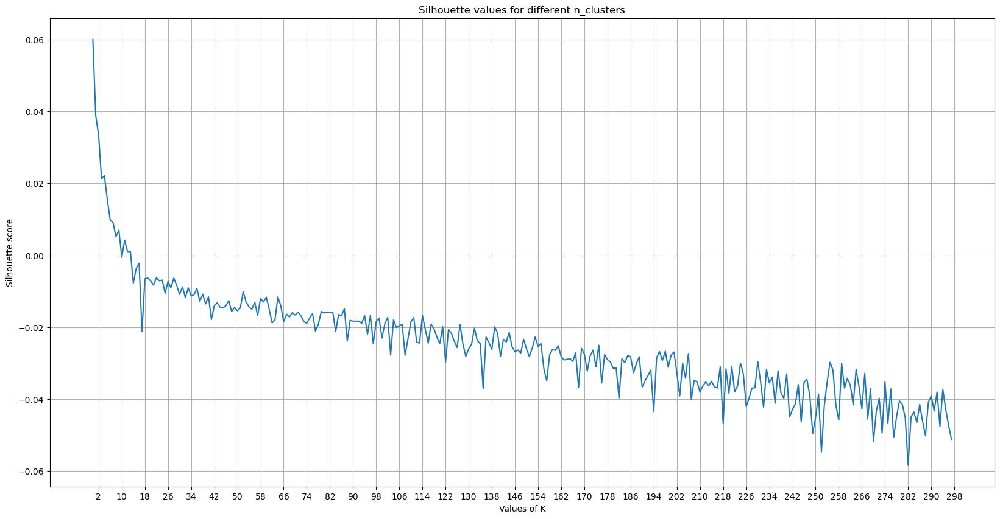

In [34]:
# plotting Silhouette scores
plt.figure(figsize=(20,10))
plt.plot(metrics_result['Silhouette Coefficient'])
plt.xlabel('Values of K')
plt.xticks(list_of_cluster_size[1::8])
plt.ylabel('Silhouette score')
plt.title('Silhouette values for different n_clusters (Word2Vec)')
plt.grid()
plt.show()

In [35]:
# get the index of maximum Silhouette score
K = np.argmax(metrics_result['Silhouette Coefficient']) + 2 # added 2 because cluster size is greater 2 than index
K

2

### Train the MiniBatchKMeans with best K value

In [36]:
# !pip install --upgrade wordcloud 

In [65]:
kmeans = MiniBatchKMeans(
    n_clusters=K,
    max_iter=1000,
    n_init=20
)
fit_and_evaluate(kmeans, sentence_vectors)

Clustering done in 0.39 ± 0.13 s
Silhouette Coefficient: 0.063 ± 0.021
Calinski-Harabasz Index: 2284.764 ± 223.842
Davies-Bouldin Index: 4.108 ± 0.389


{'Silhouette Coefficient': 0.06285892470737756,
 'Calinski-Harabasz Index': 2284.7639865951464,
 'Davies-Bouldin Index': 4.107925853985307}

In [63]:
visualize_data_3d(sentence_vectors, kmeans.labels_, "../result/word2vec_mbkmeans.html")

## Using community_detection algorithm

`sentence_transfomers` has a `community_detection` algorithm that quickly finds local communities of similar sentences in a large list of sentence_embeddings.

It has two hyper-parameters that can be used to control the tightness and minimum size of the clusters: the threshold `t` and minimum community size `k`.


### Working of the algorithm
The algorithm works as follows; 
- it starts by comparing the similarity of all sentences with all other sentences by calculating the pairwise cosine similarities of the sentence embeddings. 
- Then, for each sentence, it selects all other sentences that have a cosine similarity score bigger than the predefined threshold t. 
- It then sorts all sentences by cluster size (i.e. the number of other sentences within the threshold) and keeps the biggest clusters that do not overlap with an existing cluster and have at least k sentences in it.
- The first sentence in each cluster is the most central sentence of that cluster. All other sentences have a cosine similarity of at least t with this sentence.

### NOTE:
<pre>
community_detection algorithm does not ensure that all sentences are clustered.

It will find regions with high density (cosine similarity higher than the threshold). It then returns the center point as cluster node plus all sentences within that region.

If a sentence is now outside of that threshold, it will not be returned. It will also not be part of another cluster if in that area are not sufficient sentences to create a new cluster.
</pre>

<hr>
<pre>
Function for Fast Community Detection

Finds in the embeddings all communities, i.e. embeddings that are close (closer than threshold).

Returns only communities that are larger than min_community_size. The communities are returned
in decreasing order. The first element in each list is the central point in the community.
</pre>

In [39]:
# !pip install sentence_transformers

|time taken|min_community_size|threshold| clustered datapoints|
| :-----   |           :----: |  :----: | -------------------:|
|1520s|5|0.60| re-check|
|1477s|100|0.60| re-check|
|154s|200|0.70| 10459|


In [40]:
from sentence_transformers import util
import torch
t0 = time()
clusters = util.community_detection(
    torch.Tensor(sentence_vectors),
#     min_community_size=100,
#     threshold=0.50,
)
print(f"time taken to create clusters is: {time()-t0}")

time taken to create clusters is: 261.7578263282776


In [41]:
len(clusters) # no.of clusters

473

In [42]:
cluster_count = {} # no.of documents in each cluster
for i, cluster in enumerate(clusters):
    cluster_count[i] = len(cluster)

In [53]:
print(f"total {sum(cluster_count.values())} datapoints got clustered")

total 12790 datapoints got clustered


#### visualize using 3D

In [45]:
count = 0
for sentence_id in clusters[-10]:
    print(f"sentence id: {sentence_id}")
    print("".join(original_dataset["Text"].iloc[sentence_id]))
    print("-"*10)
    count+=1
print("=="*20)
print(f"Total no.of docs in the cluster: {count}")

sentence id: 8304
Shippensburg Area School District administrative costs per pupil was $605.42 in 2008.
----------
sentence id: 8339
In 2009, the Homestead/Farmstead Property Tax Relief from gambling for the Shippensburg Area School District was set per approved permanent primary residence.
----------
sentence id: 10833
In 2008, Moniteau School District administration reported that per pupil spending was $10,753.
----------
sentence id: 16265
Per pupil spending Millville Area School District administrative costs per pupil were $873.09 in 2008.
----------
sentence id: 16266
In 2008, Millville Area School District reported spending $13,674 per pupil.
----------
sentence id: 16313
In 2013, the Homestead/Farmstead Property Tax Relief from gambling for the Millville Area School District was $185 per approved permanent primary residence and farmstead.
----------
sentence id: 25637
Brownsville Area School District administrative costs per pupil in 2008 was $899 per pupil, which ranked 106th i

<pre><b>We can see that the group is semantically Similar

In [46]:
# mapping clusters to the dataset
def get_labels_linear(labels, length):
    """
    this method takes clusters of labels(from community_detection algo) and return the labels in a linear array of given length
    
    NOTE: If particular index in not clustered, will assign `-1` for those.
    """
    # initializing labels list
    labels_list = [-1 for i in range(length)] 
    
    for cluster_label, cluster in enumerate(labels):
        for index in cluster:
            labels_list[index] = cluster_label
            
    return labels_list

In [50]:
labels = get_labels_linear(clusters, sentence_vectors.shape[0])
visualize_data_3d(sentence_vectors, labels, "../result/word2vec_community_detection.html")

__getting `silhouette_score`__

In [64]:
from sklearn.metrics import silhouette_score
silhouette_score(sentence_vectors, labels, metric="cosine")

-0.29120884409372133

- Getting Silhouette score on the whole dataset is not a right way to judge the clustering as every datapoints hasn't got clustered.

- But, the `community_detection` algorithm is the most intuitive algorithm.